In [40]:
import skmob
import pandas as pd
import json
from datetime import datetime
import warnings

warnings.filterwarnings(action='once')

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [41]:
data = pd.read_csv("Brightkite_totalCheckins.csv")

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [42]:
data.head()

,User,Date,Lat,Lng
0,0,2010-10-17T01:48:53Z,39.747652,-104.992510
1,0,2010-10-16T06:02:04Z,39.891383,-105.070814
2,0,2010-10-16T03:48:54Z,39.891077,-105.068532
3,0,2010-10-14T18:25:51Z,39.750469,-104.999073
4,0,2010-10-14T00:21:47Z,39.752713,-104.996337


In [43]:
# Create a TrajDataFrame from a DataFrame
tdf = skmob.TrajDataFrame(data, 
                          latitude='Lat', 
                          datetime='Date', 
                          longitude='Lng',
                         user_id='User')

print(type(tdf))
tdf.head()

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<class 'skmob.core.trajectorydataframe.TrajDataFrame'>


,uid,datetime,lat,lng
0,0,2010-10-17 01:48:53+00:00,39.747652,-104.992510
1,0,2010-10-16 06:02:04+00:00,39.891383,-105.070814
2,0,2010-10-16 03:48:54+00:00,39.891077,-105.068532
3,0,2010-10-14 18:25:51+00:00,39.750469,-104.999073
4,0,2010-10-14 00:21:47+00:00,39.752713,-104.996337


In [7]:
tdf.plot_trajectory(zoom=11, weight=0.5, opacity=0.9, tiles='Stamen Toner')

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\scikit_mobility-1.0-py3.7.egg\skmob\utils\plot.py:143: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.


In [44]:
import numpy as np

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [45]:
# select 500 users
tdf = tdf[tdf["uid"] < 500]

In [46]:
len(np.unique(tdf["uid"]))


c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


465

In [20]:
tdf['leaving_datetime'] = tdf.datetime
user0_map = tdf.plot_stops(zoom=11)
# plot the trajectory of the user
tdf.plot_trajectory(map_f=user0_map)

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\scikit_mobility-1.0-py3.7.egg\skmob\utils\plot.py:245: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.


In [47]:
tdf.head()

,uid,datetime,lat,lng
0,0,2010-10-17 01:48:53+00:00,39.747652,-104.992510
1,0,2010-10-16 06:02:04+00:00,39.891383,-105.070814
2,0,2010-10-16 03:48:54+00:00,39.891077,-105.068532
3,0,2010-10-14 18:25:51+00:00,39.750469,-104.999073
4,0,2010-10-14 00:21:47+00:00,39.752713,-104.996337


In [48]:
print('# users: %s' %len(tdf.uid.unique()))
print('# points: %s' %len(tdf))


# users: 465
# points: 255383


c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [52]:
from skmob.preprocessing import filtering

ftdf = filtering.filter(tdf, max_speed_kmh=500.)

from IPython.display import Image


In [53]:
ftdf.parameters

{'filter': {'function': 'filter',
  'max_speed_kmh': 500.0,
  'include_loops': False,
  'speed_kmh': 5.0,
  'max_loop': 6,
  'ratio_max': 0.25}}

In [54]:
print('Points of the raw trajectory:\t\t%s'%len(tdf))
print('Points of the filtered trajectory:\t%s'%len(ftdf))
print('Filtered points:\t\t\t%s'%(len(tdf)-len(ftdf)))

Points of the raw trajectory:		255383
Points of the filtered trajectory:	248093
Filtered points:			7290


## compressing trajectory

In [55]:
from skmob.preprocessing import compression


ctdf = compression.compress(ftdf, spatial_radius_km=4)
ctdf.head()

,uid,datetime,lat,lng
0,0,2009-05-25 20:56:10+00:00,37.774929,-122.419415
1,0,2009-05-25 21:35:28+00:00,37.600747,-122.382376
2,0,2009-05-26 02:21:12+00:00,39.878664,-104.682105
3,0,2009-05-26 04:59:44+00:00,39.756723,-104.983592
4,0,2009-05-27 01:34:04+00:00,39.765342,-104.940153


In [56]:
len(ctdf) # Much smaller

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


72157

In [33]:
user0_map = ctdf.plot_stops(zoom=11)
# plot the trajectory of the user
ctdf.plot_trajectory(map_f=user0_map) ##it is hard to capture in the visualization

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\scikit_mobility-1.0-py3.7.egg\skmob\utils\plot.py:245: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.


## stop detection

In [57]:
from skmob.preprocessing import detection

In [58]:
stdf = detection.stops(ctdf, stop_radius_factor=0.5, \
            minutes_for_a_stop=20.0, spatial_radius_km=0.2, 
                       leaving_time=True)
len(stdf)

70081

In [59]:
stdf.parameters

{'filter': {'function': 'filter',
  'max_speed_kmh': 500.0,
  'include_loops': False,
  'speed_kmh': 5.0,
  'max_loop': 6,
  'ratio_max': 0.25},
 'compress': {'function': 'compress', 'spatial_radius_km': 4},
 'detect': {'function': 'stops',
  'stop_radius_factor': 0.5,
  'minutes_for_a_stop': 20.0,
  'spatial_radius_km': 0.2,
  'leaving_time': True,
  'no_data_for_minutes': 1000000000000.0,
  'min_speed_kmh': None}}

In [37]:
map_f = stdf.plot_trajectory(max_points=1000, hex_color=-1, start_end_markers=False)
stdf.plot_stops(map_f=map_f, hex_color=-1)

## Trajectory Analysis

In [61]:
stdf['uniqueDate'] = stdf['datetime'].dt.date
count = stdf.groupby('uniqueDate').count()
stdf['uniqueDate']
count.head()

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,uid,datetime,lat,lng,leaving_datetime
uniqueDate,,,,,
2008-03-22,2,1970-01-01 00:00:00.000000002,2.0,2.0,2
2008-03-23,1,1970-01-01 00:00:00.000000001,1.0,1.0,1
2008-03-24,1,1970-01-01 00:00:00.000000001,1.0,1.0,1
2008-03-27,1,1970-01-01 00:00:00.000000001,1.0,1.0,1
2008-03-28,2,1970-01-01 00:00:00.000000002,2.0,2.0,2


In [63]:
count.to_csv('count.csv')
countcsv = pd.read_csv('count.csv')
timeData = pd.to_datetime(countcsv['uniqueDate'],format='%Y-%m-%d')
countcsv['uniqueDate'] = timeData
countcsv['uniqueDate']

0     2008-03-22
1     2008-03-23
2     2008-03-24
3     2008-03-27
4     2008-03-28
         ...    
924   2010-10-12
925   2010-10-13
926   2010-10-14
927   2010-10-15
928   2010-10-16
Name: uniqueDate, Length: 929, dtype: datetime64[ns]

Text(0, 0.5, 'Number of Trips')

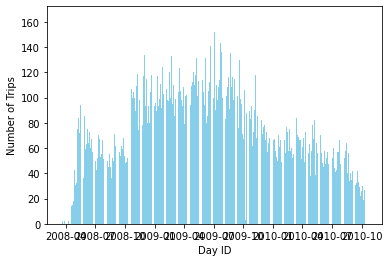

In [64]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
fig1 = ax.bar(countcsv['uniqueDate'], countcsv['leaving_datetime'], color='SkyBlue')
plt.xlabel("Day ID")
plt.ylabel("Number of Trips")

This is the trip distribution. 

There is a clear increasing stage and decreasing stage, showing that the amount of location infomation collected from apps could be unstable. In this situation, the customers used this app less after 2010.

## Distribution of duration

In [65]:
# stdf to dataframe
stdf.to_csv('stdfAll.csv')
stdf_csv = pd.read_csv('stdfAll.csv')
stdf_csv.head()

,Unnamed: 0,uid,datetime,lat,lng,leaving_datetime,uniqueDate
0,0,0,2009-05-25 20:56:10+00:00,37.774929,-122.419415,2009-05-25 21:35:28+00:00,2009-05-25
1,1,0,2009-05-25 21:35:28+00:00,37.600747,-122.382376,2009-05-26 02:21:12+00:00,2009-05-25
2,2,0,2009-05-26 02:21:12+00:00,39.878664,-104.682105,2009-05-26 04:59:44+00:00,2009-05-26
3,3,0,2009-05-26 04:59:44+00:00,39.756723,-104.983592,2009-05-27 01:34:04+00:00,2009-05-26
4,4,0,2009-05-27 01:40:47+00:00,39.739154,-104.984703,2009-05-27 04:04:27+00:00,2009-05-27


In [66]:
datetime_1 = pd.to_datetime(stdf_csv['datetime'],format='%Y-%m-%d')
datetime_2 = pd.to_datetime(stdf_csv['leaving_datetime'],format='%Y-%m-%d')
stdf_csv['datetime'] = datetime_1
stdf_csv['leaving_datetime'] = datetime_2
stdf_csv.head()

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Unnamed: 0,uid,datetime,lat,lng,leaving_datetime,uniqueDate
0,0,0,2009-05-25 20:56:10+00:00,37.774929,-122.419415,2009-05-25 21:35:28+00:00,2009-05-25
1,1,0,2009-05-25 21:35:28+00:00,37.600747,-122.382376,2009-05-26 02:21:12+00:00,2009-05-25
2,2,0,2009-05-26 02:21:12+00:00,39.878664,-104.682105,2009-05-26 04:59:44+00:00,2009-05-26
3,3,0,2009-05-26 04:59:44+00:00,39.756723,-104.983592,2009-05-27 01:34:04+00:00,2009-05-26
4,4,0,2009-05-27 01:40:47+00:00,39.739154,-104.984703,2009-05-27 04:04:27+00:00,2009-05-27


In [70]:
stdf_csv['duration'] = stdf_csv['leaving_datetime'] - stdf_csv['datetime']
stdf_csv.tail()

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Unnamed: 0,uid,datetime,lat,lng,leaving_datetime,uniqueDate,duration
70076,70076,493,2008-11-16 21:27:12+00:00,32.779815,-117.039673,2008-11-19 20:49:18+00:00,2008-11-16,2 days 23:22:06
70077,70077,493,2008-11-19 20:49:18+00:00,32.652962,-117.066021,2008-11-29 19:39:45+00:00,2008-11-19,9 days 22:50:27
70078,70078,493,2008-11-29 19:39:45+00:00,32.808545,-117.115234,2009-02-06 18:08:08+00:00,2008-11-29,68 days 22:28:23
70079,70079,497,2009-01-30 03:13:33+00:00,37.762794,-122.411454,2009-02-07 04:18:01+00:00,2009-01-30,8 days 01:04:28
70080,70080,497,2009-02-07 04:18:01+00:00,37.691986,-121.902817,2009-02-09 00:41:49+00:00,2009-02-07,1 days 20:23:48


We could see there are 68 days above, which is not reasonable. This is because the user do not use the app that much. So we could count the uid to see their login frequency. And we could drop those users whose "uid count" is less than, for example,100.

This part is optional:

In [78]:

#count_user = stdf.groupby('uid').count()

#count_user.head(100)

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,datetime,lat,lng,leaving_datetime,uniqueDate
uid,,,,,
0,1970-01-01 00:00:00.000000733,733.0,733.0,733,733
1,1970-01-01 00:00:00.000000479,479.0,479.0,479,479
2,1970-01-01 00:00:00.000001096,1096.0,1096.0,1096,1096
3,1970-01-01 00:00:00.000000645,645.0,645.0,645,645
4,1970-01-01 00:00:00.000000183,183.0,183.0,183,183
...,...,...,...,...,...
98,1970-01-01 00:00:00.000000041,41.0,41.0,41,41
99,1970-01-01 00:00:00.000000031,31.0,31.0,31,31
100,1970-01-01 00:00:00.000000006,6.0,6.0,6,6


In [80]:
# convert the duration to float number of time (hours)
stdf_csv['timeFloat']=(stdf_csv['duration']/np.timedelta64(1, 'D')).astype(float)

In [91]:
# set intervals for count
interval = pd.cut(stdf_csv['timeFloat'].values, bins=[0.0, 0.1, 0.2, 0.3, 0.4, 0.5,0.6,0.7,0.8,
                                                         0.9,1.0,1.1,1.2,1.3,1.4,1.5,1.6,1.7,1.8,stdf_csv['timeFloat'].max()+1])
frequency = interval.value_counts() 
frequency_df = pd.DataFrame(frequency, columns=['Frequency'])
frequency_df['probability'] =  frequency_df['Frequency'] / 70080
frequency_df['Density'] =  frequency_df['probability'] /0.1

frequency_df['range'] = a=np.arange(0.5,19.5)
frequency_df['xvalue'] = frequency_df['range'] / 10
frequency_df

,Frequency,probability,Density,range,xvalue
"(0.0, 0.1]",9761,0.139284,1.392837,0.5,0.05
"(0.1, 0.2]",7796,0.111244,1.112443,1.5,0.15
"(0.2, 0.3]",4751,0.067794,0.677939,2.5,0.25
"(0.3, 0.4]",4274,0.060987,0.609874,3.5,0.35
"(0.4, 0.5]",4124,0.058847,0.588470,4.5,0.45
"(0.5, 0.6]",4069,0.058062,0.580622,5.5,0.55
"(0.6, 0.7]",3645,0.052012,0.520120,6.5,0.65
"(0.7, 0.8]",2744,0.039155,0.391553,7.5,0.75
"(0.8, 0.9]",2467,0.035203,0.352026,8.5,0.85
"(0.9, 1.0]",2323,0.033148,0.331478,9.5,0.95


c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


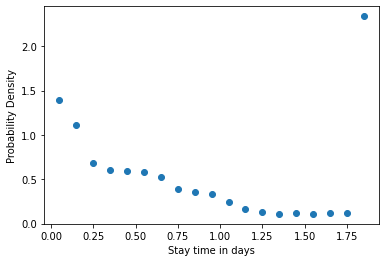

In [92]:
plt.scatter(frequency_df['xvalue'], frequency_df['Density'])  
plt.xlabel("Stay time in days")
plt.ylabel("Probability Density")
plt.show()


There is an abnormal point in the end. This is also caused by the "low frequency users"

## distribution of total travel

In [84]:
from skmob.utils.gislib import getDistanceByHaversine
from skmob.measures.individual import distance_straight_line

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\scikit_mobility-1.0-py3.7.egg\skmob\measures\individual.py:81: DeprecationWarning: invalid escape sequence \s
c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\scikit_mobility-1.0-py3.7.egg\skmob\measures\individual.py:543: DeprecationWarning: invalid escape sequence \D
c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\scikit_mobility-1.0-py3.7.egg\skmob\measures\individual.py:630: DeprecationWarning: invalid escape sequence \m
c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\scikit_mobility-1.0-py3.7.egg\skmob\measures\individual.py:1328: DeprecationWarning: invalid escape sequence \o
c:\users\administrator\anaconda3\envs\skmob\lib\importlib\_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)
c:\users\administrator\anaconda3\envs\skmob\lib\importlib\_bootstrap.py:219:

In [87]:
stdf['distance'] = ' '
d = []
for i in range(70080):
    start_loc = stdf.iloc[i][['lat', 'lng']]
    end_loc = stdf.iloc[i+1][['lat', 'lng']]
    distance = getDistanceByHaversine(end_loc, start_loc)
    d.append(distance)
d.append(0)
stdf['distance'] = d 
stdf.head()

,uid,datetime,lat,lng,leaving_datetime,uniqueDate,distance
0,0,2009-05-25 20:56:10+00:00,37.774929,-122.419415,2009-05-25 21:35:28+00:00,2009-05-25,19.640467
1,0,2009-05-25 21:35:28+00:00,37.600747,-122.382376,2009-05-26 02:21:12+00:00,2009-05-25,1553.265749
2,0,2009-05-26 02:21:12+00:00,39.878664,-104.682105,2009-05-26 04:59:44+00:00,2009-05-26,29.101011
3,0,2009-05-26 04:59:44+00:00,39.756723,-104.983592,2009-05-27 01:34:04+00:00,2009-05-26,1.955893
4,0,2009-05-27 01:40:47+00:00,39.739154,-104.984703,2009-05-27 04:04:27+00:00,2009-05-27,16.699415


In [88]:
# stdfAll to dataframe
stdf.to_csv('stdfAll1.csv')
stdfAll_csv = pd.read_csv('stdfAll1.csv')
stdfAll_csv.head()

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Unnamed: 0,uid,datetime,lat,lng,leaving_datetime,uniqueDate,distance
0,0,0,2009-05-25 20:56:10+00:00,37.774929,-122.419415,2009-05-25 21:35:28+00:00,2009-05-25,19.640467
1,1,0,2009-05-25 21:35:28+00:00,37.600747,-122.382376,2009-05-26 02:21:12+00:00,2009-05-25,1553.265749
2,2,0,2009-05-26 02:21:12+00:00,39.878664,-104.682105,2009-05-26 04:59:44+00:00,2009-05-26,29.101011
3,3,0,2009-05-26 04:59:44+00:00,39.756723,-104.983592,2009-05-27 01:34:04+00:00,2009-05-26,1.955893
4,4,0,2009-05-27 01:40:47+00:00,39.739154,-104.984703,2009-05-27 04:04:27+00:00,2009-05-27,16.699415


In [97]:
# set intervals for count
interval1 = pd.cut(stdfAll_csv['distance'].values, bins=[5.0, 10.0, 15.0,20.0,25.0,30.0,35.0,40.0,45.0,50.0,55.0
                                                          ,60.0,65.0,70.0,75.0,80.0,85.0,90.0,95.0])
frequency1 = interval1.value_counts() 
frequency_df1 = pd.DataFrame(frequency1, columns=['Frequency'])
frequency_df1['probability'] =  frequency_df1['Frequency'] / 70080
frequency_df1['Density'] =  frequency_df1['probability'] /5.0

frequency_df1['range'] = np.arange(1,19)
frequency_df1['xvalue'] = frequency_df1['range'] *5
frequency_df1

c:\users\administrator\anaconda3\envs\skmob\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Frequency,probability,Density,range,xvalue
"(5.0, 10.0]",15503,0.221219,0.044244,1,5
"(10.0, 15.0]",11255,0.160602,0.032120,2,10
"(15.0, 20.0]",7663,0.109346,0.021869,3,15
"(20.0, 25.0]",5960,0.085046,0.017009,4,20
"(25.0, 30.0]",3327,0.047474,0.009495,5,25
"(30.0, 35.0]",2304,0.032877,0.006575,6,30
"(35.0, 40.0]",2492,0.035559,0.007112,7,35
"(40.0, 45.0]",1311,0.018707,0.003741,8,40
"(45.0, 50.0]",1120,0.015982,0.003196,9,45
"(50.0, 55.0]",823,0.011744,0.002349,10,50


Text(0, 0.5, 'Probability Density')

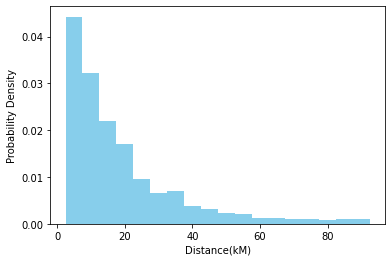

In [101]:
fig, ax = plt.subplots()
fig2 = ax.bar(frequency_df1['xvalue'], frequency_df1['Density'], color='SkyBlue', width = 5)
plt.xlabel("Distance(kM)")
plt.ylabel("Probability Density")

We just drop those super-long distance when calculating the Probability density, there is no abnormal point